# **Import Library**

In [ ]:
!pip install tensorflow

In [ ]:
!pip install tensorflowjs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 3.9 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully uninstalled packaging-24.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
db-dtypes 1.4.3 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.
google-cloud-bigquery 3.32.0 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.


In [ ]:
# Mengimpor libraries umum yang sering digunakan
import os, shutil
import zipfile
import random
from random import sample
import shutil
from shutil import copyfile
import pathlib
from pathlib import Path
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm as tq

# Mengimpor libraries untuk visualisasi
%matplotlib inline
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from PIL import Image
import seaborn as sns
from matplotlib.image import imread

# Mengimpor libraries untuk pemrosesan data gambar
import cv2
from PIL import Image
import skimage
from skimage import io
from skimage.transform import resize
from skimage.transform import rotate, AffineTransform, warp
from skimage import img_as_ubyte
from skimage.exposure import adjust_gamma
from skimage.util import random_noise

# Mengimpor libraries untuk pembuatan dan evaluasi model
import keras
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
import tensorflow as tf
from tensorflow.keras import Model, layers
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import Callback, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras import Sequential, layers, applications, optimizers, callbacks
import tensorflowjs as tfjs

# Mengabaikan peringatan
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

#**Loading Dataset**

In [ ]:
# Import module yang disediakan google colab untuk kebutuhan upload file
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"saniskalita","key":"7866ef8cb9a7e995a8abaf1a0eede5c8"}'}

In [ ]:
# Menghapus folder "NutriScore Dataset" jika sudah ada sebelumnya
!rm -rf "NutriScore Dataset"

# Menyiapkan folder .kaggle untuk menyimpan kredensial API Kaggle
!mkdir -p ~/.kaggle

# Menyalin file kaggle.json yang berisi API key ke dalam folder yang tepat
!cp kaggle.json ~/.kaggle/

# Memberikan hak akses agar file kaggle.json dapat dibaca oleh API Kaggle
!chmod 600 ~/.kaggle/kaggle.json

# Mengunduh dataset "NutriScore Dataset" dari Kaggle
!kaggle datasets download -d feniakarenina/nutriscore-dataset

# Mengekstrak file zip yang berisi dataset setelah diunduh
!unzip nutriscore-dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: Pepes Ikan/00000131.jpg  
  inflating: Pepes Ikan/00000132.jpg  
  inflating: Pepes Ikan/00000133.jpg  
  inflating: Pepes Ikan/00000134.jpg  
  inflating: Pepes Ikan/00000135.jpg  
  inflating: Pepes Ikan/00000136.jpg  
  inflating: Pepes Ikan/00000137.jpg  
  inflating: Pepes Ikan/00000138.jpg  
  inflating: Pepes Ikan/00000139.jpg  
  inflating: Pepes Ikan/00000140.jpg  
  inflating: Pepes Ikan/00000141.jpg  
  inflating: Pepes Ikan/00000144.jpg  
  inflating: Pepes Ikan/00000145.jpg  
  inflating: Pepes Ikan/00000146.jpg  
  inflating: Pepes Ikan/00000147.jpg  
  inflating: Pepes Ikan/00000148.jpg  
  inflating: Pepes Ikan/00000149.jpg  
  inflating: Pepes Ikan/00000150.jpg  
  inflating: Pepes Ikan/00000151.jpg  
  inflating: Pepes Ikan/00000152.jpg  
  inflating: Pepes Ikan/00000153.jpg  
  inflating: Pepes Ikan/00000154.jpg  
  inflating: Pepes Ikan/00000155.jpg  
  inflating: Pepes Ikan/00000156.jpg  
  inflating: 

In [ ]:
!ls

'Ayam Crispy'	  'Ikan Goreng'		    Rendang
'Ayam Kecap'	   kaggle.json		   'Salad Sayur'
'Ayam Serundeng'  'Kentang Balado'	    sample_data
 Bakso		  'Mie Goreng'		   'Sate Ayam'
'Bubur Ayam'	  'Nasi Bakar'		   'Sate Kambing'
 Capcay		  'Nasi Goreng'		   'Sayur Asem'
'Cumi Bakar'	  'Nasi Kuning'		   'Sayur Sop'
'Cumi Hitam'	  'Nasi Merah'		   'Soto Ayam'
'Cumi Rica'	  'Nasi Rames'		   'Telur Balado'
'Dimsum Ikan'	   nutriscore-dataset.zip  'Telur Dadar'
'French Fries'	  'Opor Ayam'		   'Tumis Kacang Panjang Tahu'
 Gado-Gado	   Pecel		   'Tumis Kangkung'
'Garang Asem'	  'Pepes Ikan'		   'Tumis Terong'
 Gudeg		  'Perkedel Kentang'	   'Udang Asam Manis'
'Ikan Bakar'	   Rawon		   'Udang Goreng Tepung'


In [ ]:
!mkdir -p NutriScoreDataset

# Pindahkan semua folder makanan ke dalam NutriScoreDataset
!mv "Ayam Crispy" "Ayam Kecap" "Ayam Serundeng" "Bakso" "Bubur Ayam" "Capcay" \
"Cumi Bakar" "Cumi Hitam" "Cumi Rica" "Gado-Gado" \
"Garang Asem" "Gudeg" "Ikan Bakar" "Ikan Goreng" "Kentang Balado" "Mie Goreng" \
"Nasi Bakar" "Nasi Goreng" "Nasi Kuning" "Nasi Merah" "Nasi Rames" "Opor Ayam" \
"Pecel" "Pepes Ikan" "Perkedel Kentang" "Rawon" "Rendang" "Salad Sayur" \
"Sayur Asem" "Sayur Sop" "Sate Ayam" "Sate Kambing" "Soto Ayam" "Telur Balado" \
"Telur Dadar" "Tumis Kacang Panjang Tahu" "Tumis Kangkung" "Tumis Terong" \
"Udang Asam Manis" "Udang Goreng Tepung" NutriScoreDataset/

## **Resize + Kompres JPG**

In [ ]:
from PIL import Image, ImageOps
import os
from tqdm import tqdm

def compress_images(input_dir, output_dir, target_size=(224, 224), quality=70, padding_color=(255, 255, 255)):
    """
    Kompres dan resize gambar dalam folder input ke ukuran target_size dengan padding
    untuk menjaga aspect ratio. Hasil disimpan di folder output dengan format JPEG.

    Args:
        input_dir (str): Folder utama berisi subfolder gambar.
        output_dir (str): Folder tujuan hasil kompresi.
        target_size (tuple): Ukuran gambar output, misal (224, 224).
        quality (int): Kualitas JPEG (0-100).
        padding_color (tuple): Warna padding, default putih (255,255,255).
    """
    os.makedirs(output_dir, exist_ok=True)

    folders = [f for f in os.listdir(input_dir) if os.path.isdir(os.path.join(input_dir, f))]

    for folder in folders:
        folder_path = os.path.join(input_dir, folder)
        save_path = os.path.join(output_dir, folder)
        os.makedirs(save_path, exist_ok=True)

        print(f"Memproses folder: {folder}")

        files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

        for file in tqdm(files, desc=f"Memproses {folder}", unit="file"):
            input_path = os.path.join(folder_path, file)
            filename_wo_ext = os.path.splitext(file)[0]
            output_path = os.path.join(save_path, f"{filename_wo_ext}.jpg")

            try:
                with Image.open(input_path) as img:
                    # Konversi mode agar aman simpan ke JPEG
                    if img.mode in ("RGBA", "P"):
                        img = img.convert("RGB")

                    # Resize dengan aspect ratio dan padding
                    img = ImageOps.fit(img, target_size, method=Image.Resampling.LANCZOS, centering=(0.5, 0.5))

                    # Simpan dengan kompresi JPEG
                    img.save(output_path, format="JPEG", quality=quality, optimize=True)

            except Exception as e:
                print(f"Gagal proses {file}: {e}")

if __name__ == "__main__":
    # Contoh pemakaian:
    compress_images(
        input_dir="NutriScoreDataset",
        output_dir="Nutri Score/dataset",
        target_size=(224, 224),
        quality=70,
        padding_color=(255, 255, 255)
    )

Memproses folder: Tumis Terong


Memproses Tumis Terong: 100%|██████████| 300/300 [00:04<00:00, 62.91file/s]


Memproses folder: Ayam Serundeng


Memproses Ayam Serundeng: 100%|██████████| 300/300 [00:04<00:00, 73.62file/s]


Memproses folder: Ikan Bakar


Memproses Ikan Bakar: 100%|██████████| 300/300 [00:06<00:00, 46.81file/s]


Memproses folder: Perkedel Kentang


Memproses Perkedel Kentang: 100%|██████████| 300/300 [00:03<00:00, 84.33file/s]


Memproses folder: Opor Ayam


Memproses Opor Ayam: 100%|██████████| 300/300 [00:03<00:00, 84.87file/s]


Memproses folder: Rendang


Memproses Rendang: 100%|██████████| 300/300 [00:05<00:00, 52.20file/s]


Memproses folder: Kentang Balado


Memproses Kentang Balado: 100%|██████████| 300/300 [00:03<00:00, 97.12file/s] 


Memproses folder: Nasi Bakar


Memproses Nasi Bakar: 100%|██████████| 300/300 [00:04<00:00, 66.82file/s]


Memproses folder: Sayur Sop


Memproses Sayur Sop: 100%|██████████| 300/300 [00:05<00:00, 56.36file/s]


Memproses folder: Udang Goreng Tepung


Memproses Udang Goreng Tepung: 100%|██████████| 300/300 [00:04<00:00, 70.85file/s]


Memproses folder: Sayur Asem


Memproses Sayur Asem: 100%|██████████| 300/300 [00:04<00:00, 66.86file/s]


Memproses folder: Telur Balado


Memproses Telur Balado: 100%|██████████| 300/300 [00:05<00:00, 57.59file/s]


Memproses folder: Mie Goreng


Memproses Mie Goreng: 100%|██████████| 299/299 [00:04<00:00, 66.69file/s]


Memproses folder: Sate Kambing


Memproses Sate Kambing: 100%|██████████| 300/300 [00:06<00:00, 49.52file/s]


Memproses folder: Capcay


Memproses Capcay: 100%|██████████| 300/300 [00:04<00:00, 69.32file/s]


Memproses folder: Sate Ayam


Memproses Sate Ayam: 100%|██████████| 300/300 [00:03<00:00, 98.60file/s]


Memproses folder: Nasi Rames


Memproses Nasi Rames: 100%|██████████| 300/300 [00:05<00:00, 56.02file/s]


Memproses folder: Ayam Crispy


Memproses Ayam Crispy: 100%|██████████| 300/300 [00:04<00:00, 60.08file/s]


Memproses folder: Ayam Kecap


Memproses Ayam Kecap: 100%|██████████| 300/300 [00:04<00:00, 61.98file/s]


Memproses folder: Telur Dadar


Memproses Telur Dadar: 100%|██████████| 300/300 [00:03<00:00, 81.74file/s]


Memproses folder: Udang Asam Manis


Memproses Udang Asam Manis: 100%|██████████| 300/300 [00:03<00:00, 76.23file/s]


Memproses folder: Nasi Goreng


Memproses Nasi Goreng:  57%|█████▋    | 171/300 [00:04<00:04, 31.96file/s]/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
Memproses Nasi Goreng: 100%|██████████| 300/300 [00:06<00:00, 46.29file/s]


Memproses folder: Gado-Gado


Memproses Gado-Gado: 100%|██████████| 299/299 [00:06<00:00, 45.89file/s]


Memproses folder: Ikan Goreng


Memproses Ikan Goreng: 100%|██████████| 300/300 [00:05<00:00, 57.75file/s]


Memproses folder: Bubur Ayam


Memproses Bubur Ayam: 100%|██████████| 300/300 [00:04<00:00, 70.34file/s]


Memproses folder: Pecel


Memproses Pecel: 100%|██████████| 300/300 [00:03<00:00, 78.44file/s]


Memproses folder: Nasi Kuning


Memproses Nasi Kuning: 100%|██████████| 300/300 [00:06<00:00, 43.30file/s]


Memproses folder: Salad Sayur


Memproses Salad Sayur: 100%|██████████| 300/300 [00:04<00:00, 68.94file/s]


Memproses folder: Garang Asem


Memproses Garang Asem: 100%|██████████| 300/300 [00:04<00:00, 64.01file/s]


Memproses folder: Pepes Ikan


Memproses Pepes Ikan: 100%|██████████| 300/300 [00:03<00:00, 77.45file/s]


Memproses folder: Nasi Merah


Memproses Nasi Merah: 100%|██████████| 300/300 [00:05<00:00, 55.93file/s]


Memproses folder: Soto Ayam


Memproses Soto Ayam: 100%|██████████| 300/300 [00:05<00:00, 59.86file/s]


Memproses folder: Cumi Bakar


Memproses Cumi Bakar: 100%|██████████| 300/300 [00:03<00:00, 77.75file/s]


Memproses folder: Rawon


Memproses Rawon: 100%|██████████| 300/300 [00:04<00:00, 64.16file/s]


Memproses folder: Gudeg


Memproses Gudeg: 100%|██████████| 300/300 [00:03<00:00, 90.06file/s]


Memproses folder: Bakso


Memproses Bakso: 100%|██████████| 300/300 [00:05<00:00, 56.25file/s]


Memproses folder: Cumi Hitam


Memproses Cumi Hitam: 100%|██████████| 300/300 [00:05<00:00, 56.34file/s]


Memproses folder: Tumis Kangkung


Memproses Tumis Kangkung: 100%|██████████| 300/300 [00:03<00:00, 77.37file/s]


Memproses folder: Tumis Kacang Panjang Tahu


Memproses Tumis Kacang Panjang Tahu: 100%|██████████| 300/300 [00:03<00:00, 90.61file/s]


Memproses folder: Cumi Rica


Memproses Cumi Rica: 100%|██████████| 300/300 [00:04<00:00, 66.41file/s]


## **Plot Gambar Sample di Setiap Kelas**

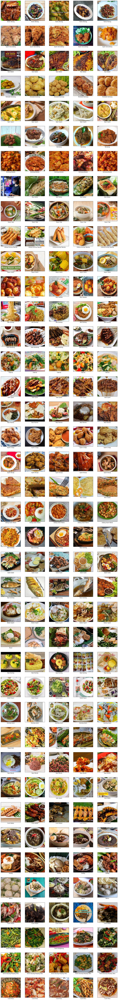

In [ ]:
# Membuat kamus yang menyimpan gambar untuk setiap kelas dalam data
food_images = {}

# Tentukan path sumber dataset
data_dir = "Nutri Score/dataset"

# Menyimpan gambar di setiap kelas dalam kamus
for category in os.listdir(data_dir):
    category_path = os.path.join(data_dir, category)
    if os.path.isdir(category_path):
        food_images[category] = os.listdir(category_path)

# Menentukan jumlah gambar yang ingin ditampilkan di bawah setiap kelas
num_images = 5

# Menentukan ukuran plot berdasarkan jumlah kelas
fig, axs = plt.subplots(len(food_images.keys()), num_images, figsize=(15, len(food_images.keys()) * 3))

# Loop untuk menampilkan gambar
for i, (class_name, images) in enumerate(food_images.items()):
    selected_images = np.random.choice(images, num_images, replace=False)

    for j, image_name in enumerate(selected_images):
        img_path = os.path.join(data_dir, class_name, image_name)
        img = Image.open(img_path).convert("RGB")  # Menggunakan RGB untuk gambar berwarna
        axs[i, j].imshow(img)
        axs[i, j].set(xlabel=class_name, xticks=[], yticks=[])

# Menyesuaikan layout agar lebih rapi
fig.tight_layout(pad=3.0)

# Menampilkan gambar
plt.show()

## **Plot Distribusi Gambar setiap Kelas**

In [ ]:
import os
import pandas as pd

# Path ke folder dataset gambar makanan
food_path = "Nutri Score/dataset"  # Ganti sesuai lokasi sebenarnya jika berbeda

# Inisialisasi list untuk menyimpan informasi
file_name = []
labels = []
full_path = []

# Menelusuri seluruh direktori untuk mendapatkan path dan label gambar
for root, dirs, files in os.walk(food_path):
    for name in files:
        # Filter hanya file gambar
        if name.lower().endswith(('.png', '.jpg', '.jpeg')):
            path_file = os.path.join(root, name)
            full_path.append(path_file)
            file_name.append(name)
            labels.append(os.path.basename(root))  # Label diambil dari nama folder terakhir

# Memasukkan data ke dalam DataFrame
df = pd.DataFrame({
    "path": full_path,
    "file_name": file_name,
    "labels": labels
})

# Menampilkan jumlah gambar untuk setiap label
print("Jumlah gambar per label:")
print(df['labels'].value_counts())

Jumlah gambar per label:
labels
Tumis Terong                 300
Ayam Serundeng               300
Ikan Bakar                   300
Perkedel Kentang             300
Opor Ayam                    300
Rendang                      300
Kentang Balado               300
Nasi Bakar                   300
Sayur Sop                    300
Udang Goreng Tepung          300
Sayur Asem                   300
Telur Balado                 300
Sate Kambing                 300
Capcay                       300
Sate Ayam                    300
Nasi Rames                   300
Udang Asam Manis             300
Ayam Crispy                  300
Ayam Kecap                   300
Telur Dadar                  300
Ikan Goreng                  300
Nasi Goreng                  300
Pecel                        300
Bubur Ayam                   300
Cumi Bakar                   300
Rawon                        300
Nasi Kuning                  300
Salad Sayur                  300
Garang Asem                  300
Pepes Ikan 

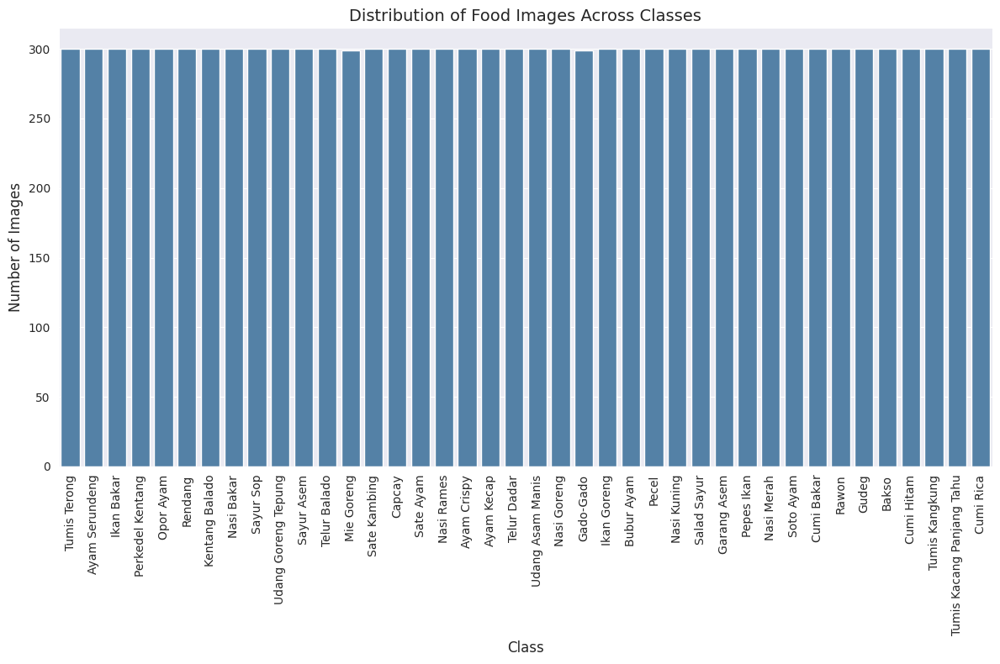

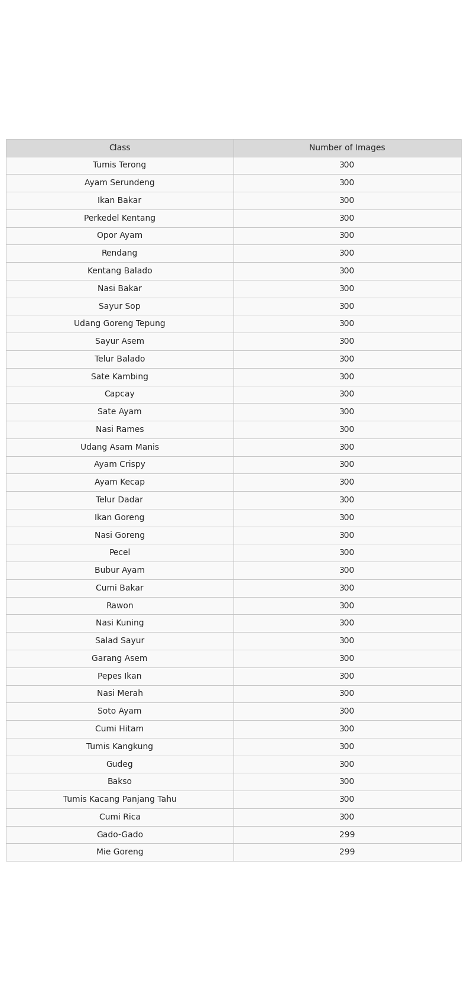

In [ ]:
# Plot distribusi jumlah gambar per kelas
plt.figure(figsize=(12, 8))  # Ukuran lebih besar agar tidak padat
sns.set_style("darkgrid")
# Changed 'label' to 'labels' to match the column name in the dataframe
plot_data = sns.countplot(x='labels', data=df, color="steelblue")  # Menggunakan warna tunggal yang profesional

# Memberi judul dan label
plt.title('Distribution of Food Images Across Classes', fontsize=14)
plt.xlabel('Class', fontsize=12)
plt.ylabel('Number of Images', fontsize=12)
plt.xticks(rotation=90, fontsize=10)  # Rotasi 90 derajat untuk menghindari tumpang tindih
plt.tight_layout()

# Membuat tabel untuk jumlah gambar per kelas
counts = df['labels'].value_counts().reset_index() # Changed 'label' to 'labels'
counts.columns = ['Class', 'Number of Images']

# Plot table jumlah gambar per kelas
plt.figure(figsize=(8, len(counts) * 0.4 + 1))  # Menyesuaikan tinggi tabel
plt.axis('off')
table = plt.table(cellText=counts.values,
                  colLabels=counts.columns,
                  loc='center',
                  cellLoc='center',
                  colLoc='center',
                  cellColours=[['#f9f9f9', '#f9f9f9']] * len(counts),  # Warna latar sel
                  colColours=['#d9d9d9', '#d9d9d9'])  # Warna header
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1.4)
for (row, col), cell in table.get_celld().items():
    cell.set_edgecolor('#bbbbbb')
    cell.set_linewidth(0.5)

# Menampilkan semua visualisasi
plt.tight_layout()
plt.show()

# **Data Preprocessing**

In [12]:
# Variabel yang digunakan pada pemisahan data ini dimana variabel X = data path dan Y = data labels
X = df['path']
y = df['labels']

# Split dataset awal menjadi data train (80%) dan test (20%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=300)

# Split data train lebih lanjut menjadi train (80%) dan validation (20%) dari data train awal
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=300)

# Cek jumlah data train, validation, dan test
print(f'Train size: {len(X_train)}')
print(f'Validation size: {len(X_val)}')
print(f'Test size: {len(X_test)}')

Train size: 7678
Validation size: 1920
Test size: 2400


In [13]:
# Menyatukan data train, validation, dan test ke dalam dataframe masing-masing
df_tr = pd.DataFrame({'path': X_train, 'labels': y_train, 'set': 'train'})
df_val = pd.DataFrame({'path': X_val, 'labels': y_val, 'set': 'validation'})
df_te = pd.DataFrame({'path': X_test, 'labels': y_test, 'set': 'test'})

# Gabungkan DataFrame train, validation, dan test ke dalam satu DataFrame
df_all = pd.concat([df_tr, df_val, df_te], ignore_index=True)

# Tampilkan distribusi data dalam bentuk tabel
distribution = df_all.groupby(['set', 'labels']).size().unstack(fill_value=0)
display(distribution)

labels,Ayam Crispy,Ayam Kecap,Ayam Serundeng,Bakso,Bubur Ayam,Capcay,Cumi Bakar,Cumi Hitam,Cumi Rica,Gado-Gado,...,Sayur Asem,Sayur Sop,Soto Ayam,Telur Balado,Telur Dadar,Tumis Kacang Panjang Tahu,Tumis Kangkung,Tumis Terong,Udang Asam Manis,Udang Goreng Tepung
set,,,,,,,,,,,,,,,,,,,,,
test,68,63,54,52,61,50,63,63,62,66,...,55,63,42,49,62,64,70,69,64,65
train,194,201,205,188,201,208,189,197,188,183,...,190,191,211,198,184,179,180,180,186,197
validation,38,36,41,60,38,42,48,40,50,50,...,55,46,47,53,54,57,50,51,50,38


## **Image Data Generator**

In [14]:
# Tentukan folder untuk menampung data final
datasource_path = "Nutri Score/ dataset"
dataset_path = "Dataset-Final/"

# Membuat folder untuk training dan testing
for index, row in tq(df_all.iterrows()):
    file_path = row['path']
    if os.path.exists(file_path) == False:
        file_path = os.path.join(datasource_path, row['labels'], row['file_name'].split('.')[0])

    # Buat direktori tujuan folder untuk masing-masing data set
    if os.path.exists(os.path.join(dataset_path, row['set'], row['labels'])) == False:
        os.makedirs(os.path.join(dataset_path, row['set'], row['labels']))

    # Tentukan tujuan file
    destination_file_name = file_path.split('/')[-1]
    file_dest = os.path.join(dataset_path, row['set'], row['labels'], destination_file_name)

    # Salin file dari sumber ke tujuan
    if os.path.exists(file_dest) == False:
        shutil.copy2(file_path, file_dest)

0it [00:00, ?it/s]

In [21]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Direktori untuk training, testing, dan validation
TRAIN_DIR = "Dataset-Final/train/"
VAL_DIR = "Dataset-Final/validation/"
TEST_DIR = "Dataset-Final/test/"

# Data Augmentation hanya untuk training set
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=25,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.2,
    zoom_range=0.3,
    horizontal_flip=True,
    brightness_range=[0.2, 1.5],
    fill_mode='nearest',
)

# Hanya rescaling untuk validation dan test set
val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

# Generator untuk training
train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    color_mode='rgb'
)

# Generator untuk validation
validation_generator = val_datagen.flow_from_directory(
    VAL_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False,
    color_mode='rgb'
)

# Generator untuk testing
test_generator = test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False,
    color_mode='rgb'
)


Found 7678 images belonging to 40 classes.
Found 1920 images belonging to 40 classes.
Found 2400 images belonging to 40 classes.


# **Modelling**

In [24]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

num_classes = 40
input_shape = (224, 224, 3)

# Load pretrained MobileNetV2 tanpa top layer
base_model = MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')

# Unfreeze bagian atas dari base_model
for layer in base_model.layers[-20:]:
    layer.trainable = True

# Tambahkan layer klasifikasi di atas base_model
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.2)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.3)(x)
output = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=output)

# Compile model
model.compile(
    optimizer=Adam(learning_rate=3e-5),  # lebih kecil supaya tidak over-update pretrained weight
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_3[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,596,200 (9.90 MB)

 Trainable params: 2,562,088 (9.77 MB)

 Non-trainable params: 34,112 (133.25 KB)

In [25]:
lr_scheduler = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.2,
    patience=3,
    min_lr=1e-6,
    verbose=1
)
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    lr_scheduler
]

epochs = 30

history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator,
    callbacks=callbacks
)

Epoch 1/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 177s 550ms/step - accuracy: 0.0410 - loss: 3.8776 - val_accuracy: 0.1323 - val_loss: 3.3817 - learning_rate: 3.0000e-05
Epoch 2/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 111s 461ms/step - accuracy: 0.1603 - loss: 3.2312 - val_accuracy: 0.2870 - val_loss: 2.7504 - learning_rate: 3.0000e-05
Epoch 3/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 111s 462ms/step - accuracy: 0.3140 - loss: 2.5359 - val_accuracy: 0.4276 - val_loss: 2.0775 - learning_rate: 3.0000e-05
Epoch 4/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 112s 468ms/step - accuracy: 0.4452 - loss: 1.9994 - val_accuracy: 0.5312 - val_loss: 1.6346 - learning_rate: 3.0000e-05
Epoch 5/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 112s 465ms/step - accuracy: 0.5231 - loss: 1.6708 - val_accuracy: 0.6099 - val_loss: 1.3587 - learning_rate: 3.0000e-05
Epoch 6/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 110s 458ms/step - accuracy: 0.5734 - loss: 1.4840 - val_accuracy: 0.6823 - val_loss: 1.0924 - learning_rate: 3.0000e-05
Epoch 7/30
240/240 ━━━━━━━━━━━━━━━━━━━━ 

# **Evaluasi**

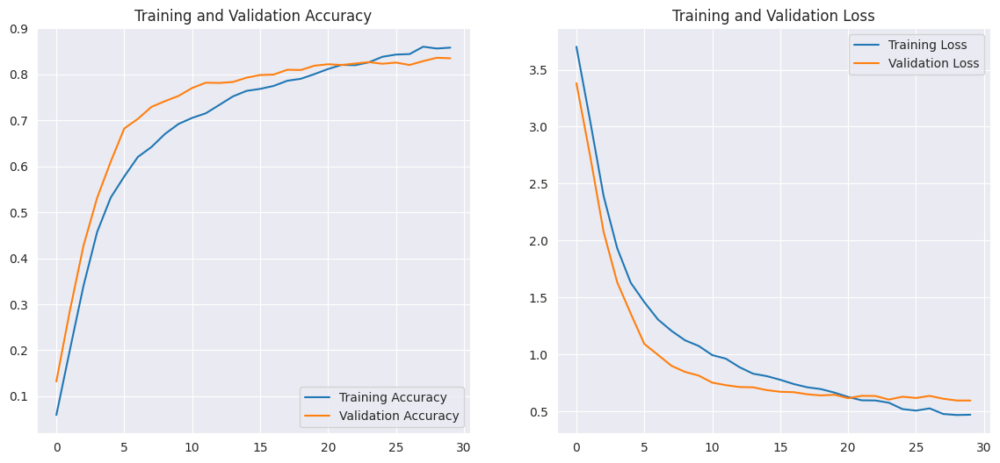

In [26]:
import matplotlib.pyplot as plt

def plot_history(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs_range = range(len(acc))

    plt.figure(figsize=(14,6))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')

    plt.show()

# Panggil fungsi
plot_history(history)

75/75 ━━━━━━━━━━━━━━━━━━━━ 7s 49ms/step
                           precision    recall  f1-score   support

              Ayam Crispy       0.87      0.85      0.86        68
               Ayam Kecap       0.80      0.78      0.79        63
           Ayam Serundeng       0.79      0.91      0.84        54
                    Bakso       0.79      0.92      0.85        52
               Bubur Ayam       0.85      0.82      0.83        61
                   Capcay       0.75      0.76      0.75        50
               Cumi Bakar       0.82      0.81      0.82        63
               Cumi Hitam       0.85      0.92      0.89        63
                Cumi Rica       0.83      0.61      0.70        62
                Gado-Gado       0.75      0.83      0.79        66
              Garang Asem       0.64      0.76      0.70        51
                    Gudeg       0.72      0.67      0.69        54
               Ikan Bakar       0.78      0.83      0.81        75
              Ikan Go

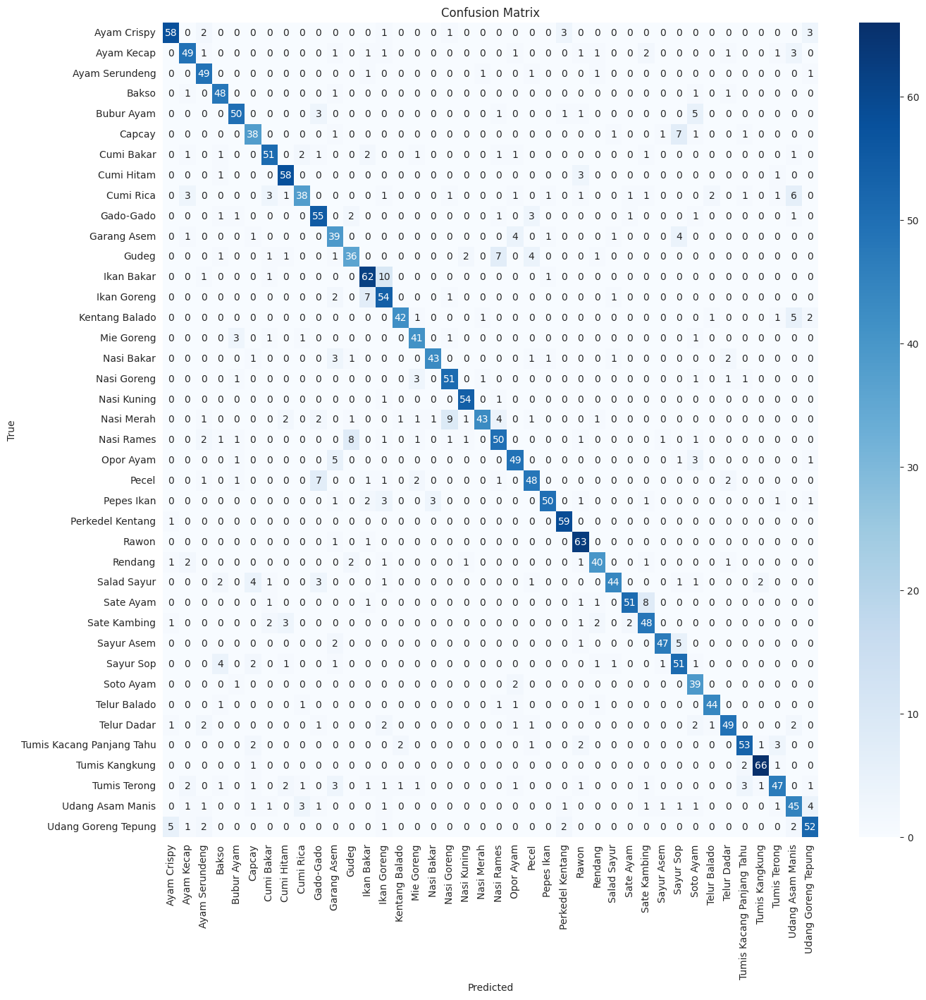

In [27]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Prediksi label test set
test_generator.reset()
pred_prob = model.predict(test_generator, verbose=1)
y_pred = np.argmax(pred_prob, axis=1)
y_true = test_generator.classes

# Nama kelas
class_names = list(test_generator.class_indices.keys())

# Classification report
print(classification_report(y_true, y_pred, target_names=class_names))

# Confusion matrix
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(15, 15))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()